## Aerial matching to 3D models
This is a simple pipeline to find the coordinates of edges, lines and specific points determined by the user.
In the end I don't use OpenMVG but rather OpenCV
- ORB
- BFMatcher

### Index
    - Satisfy prerequisites
    - Input a coarse location
    - Obtain aerial map
    - Get aerial 3D model
    - Match both of them with OpenCV

### Satisfy prerequisites

In [1]:
# Install necessary packages
!pip install geopy plotly matplotlib google_streetview numpy pandas scikit-image earthengine-api folium geehydro opencv-python bs4 mpld3

In [2]:
conda install libpng libtiff

Solving environment: ...working... done

## Package Plan ##

  environment location: C:\Users\soria\anaconda3

  added / updated specs:
    - libpng
    - libtiff


The following packages will be downloaded:

    package                    |            build
    ---------------------------|-----------------
    libtiff-4.2.0              |       hd0e1b90_0         786 KB
    ------------------------------------------------------------
                                           Total:         786 KB

The following packages will be UPDATED:

  ca-certificates    anaconda::ca-certificates-2020.10.14-0 --> pkgs/main::ca-certificates-2021.10.26-haa95532_2
  certifi                anaconda::certifi-2020.6.20-py38_0 --> pkgs/main::certifi-2021.10.8-py38haa95532_0
  libtiff                                  4.1.0-h56a325e_1 --> 4.2.0-hd0e1b90_0




libtiff-4.2.0        | 786 KB    |            |   0% 
libtiff-4.2.0        | 786 KB    | #2         |  12% 
libtiff-4.2.0        | 786 KB    | #####

In [1]:
%matplotlib inline

from geopy.geocoders import Nominatim
import plotly.express as px
from streetview_functions import *
import matplotlib.pyplot as plt
import google_streetview.api
import google_streetview.helpers
import numpy as np
import os
import subprocess
import sys
import ee
import folium
import geehydro
import folium
import cv2
from os import path
from pathlib import PurePath
import sys

from bs4 import BeautifulSoup
import requests
import glob
import pandas as pd
import mpld3
mpld3.enable_notebook()

### Where are you working?

In [2]:
input('Fill you current working folder!!!!')
cap_folder = "day13dec"

Fill you current working folder!!!!day13dec


### Input a coarse location

In [3]:
# Input roughly where are you

loc = Nominatim(user_agent="GetLoc")
place = input('Where are you?:')

Where are you?:San Gimignano


In [4]:
# Check place properties

loc.geocode(place).raw

{'place_id': 238296,
 'licence': 'Data © OpenStreetMap contributors, ODbL 1.0. https://osm.org/copyright',
 'osm_type': 'node',
 'osm_id': 61753737,
 'boundingbox': ['43.4677493', '43.4678493', '11.0431615', '11.0432615'],
 'lat': '43.4677993',
 'lon': '11.0432115',
 'display_name': 'San Gimignano, Piazza Duomo, Santa Chiara, San Gimignano, Siena, Toscana, 53038, Italia',
 'class': 'tourism',
 'type': 'attraction',
 'importance': 0.721968045467817,
 'icon': 'https://nominatim.openstreetmap.org/ui/mapicons//poi_point_of_interest.p.20.png'}

In [5]:
# Locate roughly on map to check

getLoc = loc.geocode(place)
fig = px.scatter_geo(lon=[getLoc.longitude], lat=[getLoc.latitude], projection="kavrayskiy7",title='Coarse location of query')    
fig.show()

### Obtain an aerial map

In [6]:
# Trigger the authentication flow and initialize the library

ee.Authenticate()
ee.Initialize()

Enter verification code: 4/1AX4XfWjJaqX4_hodm0rwRbA-EApte_E4prHV5qtdb9xbcZPvUvZSVSyU6g8

Successfully saved authorization token.


In [7]:
# Create folium map. You can easily check the latitudes and longitudes of each point in the map.

Map = folium.Map(location=[getLoc.latitude,  getLoc.longitude], zoom_start=60,control_scale=True)
Map.setOptions('SATELLITE')
Map.setControlVisibility(layerControl=True, fullscreenControl=True, latLngPopup=True)

In [8]:
from folium.plugins import MousePosition
formatter = "function(num) {return L.Util.formatNum(num, 10) + ' º ';};"

MousePosition(
    position="topright",
    separator=" | ",
    empty_string="NaN",
    lng_first=True,
    num_digits=20,
    prefix="Coordinates:",
    lat_formatter=formatter,
    lng_formatter=formatter,
).add_to(Map)

from folium.plugins import Draw
draw = Draw(
       draw_options={
          'polyline':False,
          'rectangle':True,
          'polygon':True,
          'circle':False,
          'marker':True,
          'circlemarker':False},
       edit_options={'edit':False})
Map.add_child(draw)

In [11]:
Map.save('mapita.html')

#### Instructions:
- Open the map in full view
- Windows + Impr. Pantalla to take screenshot
- It is automatically saved to the screens_maps folder
- Save as capp.png

In [9]:
whole_text = input('What does the server say?: \n')

What does the server say?: 
{"type":"Feature","properties":{},"geometry":{"type":"Polygon","coordinates":[[[11.029447,43.462584],[11.029447,43.471538],[11.051399,43.471538],[11.051399,43.462584],[11.029447,43.462584]]]}}


In [10]:
y_down = float(whole_text.split(',')[-1][0:-5])
x_left = float(whole_text.split(',')[-2][1:])
x_right = float(whole_text.split(',')[-4][1:])
y_up = float(whole_text.split(',')[-5][0:-1])
print('y_down=',y_down,'; x_left=',x_left, 'y_up=',y_up,'; x_right=',x_right)

y_down= 43.462584 ; x_left= 11.029447 y_up= 43.471538 ; x_right= 11.051399


In [11]:
# Load your OpenStreetView screenshot

image = cv2.imread(r'./'+cap_folder+'/capp.png',0)
width_origin = image.shape[1] #number of columns
height_origin = image.shape[0] #number of rows
print(['Height= ',height_origin,' Width= ',width_origin])

['Height= ', 1080, ' Width= ', 1920]


In [12]:
# Create a matrix of coordinates over the image shape
# Therefore each pixel has a longitude and latitude coordinate
# Not immediate

xcoords = np.linspace(float(x_left),float(x_right),width_origin)
ycoords = np.linspace(float(y_down),float(y_up),height_origin)
coordinates = list(np.empty((height_origin,width_origin,2)))
for m in range(height_origin):
    for n in range(width_origin):
        coordinates[m][n][0]=xcoords[n]
        coordinates[m][n][1]=ycoords[m]
coord = np.flipud(np.array(coordinates))

In [13]:
# Check if there is still a NaN that hasn't been filled
# Should be false
np.isnan(np.sum(coord))

False

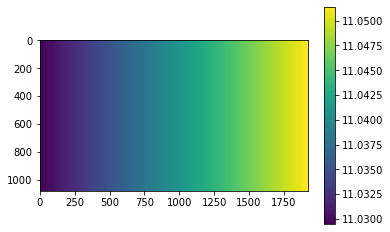

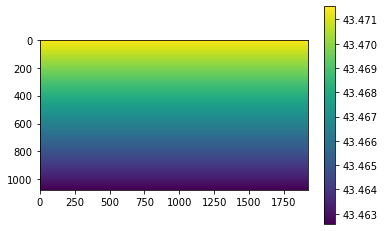

In [14]:
#Check if the matrix is correctly oriented

plt.imshow(np.array(coord)[:,:,0])
plt.colorbar()
plt.show()

plt.imshow(np.array(coord)[:,:,1])
plt.colorbar()
plt.show()

### Get aerial 3D model


#### Instructions:
- Open CloudCompare
- Open the 3D meshed model
- Take zoom screencaptures when appropriate
- It is automatically saved to the screens_maps folder (z0.png)

### Match both of them with OpenMVG or a neural network
- OpenMVG doesn't give good results
- Change the paths if needed
- The final results are ok


**First attempt with OpenMVG: not working at all**

# do not change this
camera_file_params = r"/mnt/c/Documents\ and\ Settings/soria/Google\ Drive/semester\ project\ ALBANE/openMVG/src/openMVG/exif/sensor_width_database/sensor_width_camera_database.txt"

print ("1. Intrinsics analysis")
pIntrisics = subprocess.run(["openMVG_main_SfMInit_ImageListing -i "+cap_folder+" -o "+cap_folder+" -d "+camera_file_params+" -f 1536 -c 3"],shell=True )
#pIntrisics.wait()

print ("2. Compute features")
pFeatures = subprocess.run(["openMVG_main_ComputeFeatures -i "+cap_folder+"/sfm_data.json -o "+cap_folder+" -p ULTRA"],shell=True )
#pFeatures.wait()


# This is not used in reality

print ("3. Export keypoints")
pKeyPoints = subprocess.run(["openMVG_main_exportKeypoints -i "+cap_folder+"/sfm_data.json -d "+cap_folder+" -o "+cap_folder],shell=True)
#pKeyPoints.wait()

print ("4. Compute matches")
pMatches = subprocess.run(["openMVG_main_ComputeMatches -i "+cap_folder+"/sfm_data.json -o "+cap_folder],shell=True )
#pMatches.wait()

# This is also not used

print ("5. Export matches")
pKeyMatches = subprocess.run(["openMVG_main_exportMatches -i "+cap_folder+"/sfm_data.json -o "+cap_folder+" -m "+cap_folder+"/matches.f.bin -d "+cap_folder],shell=True )
#pKeyMatches.wait()

print ("6. Incremental SfM")
pIncrementalSfM = subprocess.run(["openMVG_main_IncrementalSfM -i "+cap_folder+"/sfm_data.json -o "+cap_folder+" -m "+cap_folder],shell=True )
#pIncrementalSfM.wait()
#  -a  gsv_0.JPG -b gsv_4.JPG

---

**Second attempt with ORB WORKING**

In [15]:
# import stuff
import cv2
import numpy as np 
import matplotlib
from matplotlib import pyplot as plt 

In [16]:
# load images
img1 = cv2.imread('./'+cap_folder+'/capp.png', 0)
img2 = cv2.imread('./'+cap_folder+'/z8.png', 0)
print('img1 dtype = ',img1.dtype)
print('img2 dtype = ',img2.dtype)

img1 dtype =  uint8
img2 dtype =  uint8


In [17]:
# create object
sift = cv2.ORB_create(nfeatures=500)

# compute keypoints and descriptors in both images
kp1, des1 = sift.detectAndCompute(img1, None)
kp2, des2 = sift.detectAndCompute(img2, None)

In [18]:
# cast data to an appropriate type (unsigned integer 8 bits)
des1b = np.uint8(des1)
print('des1b type = ',des1b.dtype)
des2b = np.uint8(des2)
print('des2b type = ',des2b.dtype)

des1b type =  uint8
des2b type =  uint8


In [19]:
# create the matcher object with parameter:
# - NORM_L2
# - NORM_L1
# - NORM_HAMMING: looks like there are more matches
# - NORM_HAMMING2
bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)

In [20]:
# compute the matches (slow if lots of matches)
matches = bf.match(des1b, des2b)
print('number of matches = ',len(matches),', notice it might not be the same as nfeatures defined!')

number of matches =  153 , notice it might not be the same as nfeatures defined!


DMatch.distance - Distance between descriptors. The lower, the better it is.

DMatch.trainIdx - Index of the descriptor in train descriptors

DMatch.queryIdx - Index of the descriptor in query descriptors

DMatch.imgIdx - Index of the train image.

https://docs.opencv.org/4.x/dc/dc3/tutorial_py_matcher.html 

In [21]:
# it only draws the first N_imp most important matches
N_imp = input('N_imp = (put 100 if in doubt)')
matches = sorted(matches, key=lambda x: x.distance)
match_img = cv2.drawMatches(img1, kp1, img2, kp2, matches[:int(N_imp)], cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

N_imp = (put 100 if in doubt)100


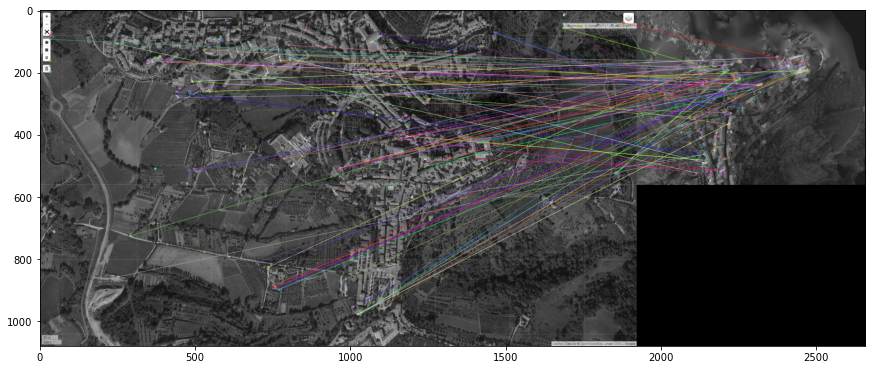

In [22]:
# plot the image with its vertices in red
# the image is converted from RGB-> BGR because plt needs BGR
fig, ax = plt.subplots(1,1,figsize=(12,12),constrained_layout = True)
ax.imshow(match_img[...,::-1])
plt.show()

In [23]:
src_pts = np.float32([ kp1[m.queryIdx].pt for m in matches ]).reshape(-1,1,2)
dst_pts = np.float32([ kp2[m.trainIdx].pt for m in matches ]).reshape(-1,1,2)

In [24]:
# Find the points of each line
# Recover the latitude and longitude pointsn using the pixels in the .svg source code and coord matrix
# Fill the new coordinates_output matrix with the recovered coordinates

coordis_tomap = []
xpoints = []
ypoints = []

In [25]:
height_out = match_img.shape[0]
width_out = match_img.shape[1]
aux = np.empty((height_out,width_out,2))
aux[:] = np.nan
coordinates_output = list(aux)
print(['Height= ',height_out,' Width= ',width_out])

['Height= ', 1080, ' Width= ', 2658]


In [26]:

for p in range(len(src_pts)):
    px1 = round(src_pts[p][0][0])
    py1 = round(src_pts[p][0][1])
    
    px2 = round(dst_pts[p][0][0])
    py2 = round(dst_pts[p][0][1])
    
    long = coord[py1][px1][0]
    lat = coord[py1][px1][1]
    px2_norm = px2# - width_origin
    py2_norm = py2
    
    xpoints.append(px2_norm)
    ypoints.append(py2_norm)
    print([' px2_norm=',px2_norm,' py2_norm=',py2_norm,' lat=',lat,' long=',long])
    coordinates_output[py2_norm][px2_norm][0]=lat
    coordinates_output[py2_norm][px2_norm][1]=long
    coordis_tomap.append({'lat':lat,'long':long})

[' px2_norm=', 217, ' py2_norm=', 463, ' lat=', 43.464426250231696, ' long=', 11.032329701406983]
[' px2_norm=', 218, ' py2_norm=', 226, ' lat=', 43.46725601297498, ' long=', 11.034937859822824]
[' px2_norm=', 282, ' py2_norm=', 197, ' lat=', 43.46721452085264, ' long=', 11.05070120323085]
[' px2_norm=', 395, ' py2_norm=', 240, ' lat=', 43.46733899721965, ' long=', 11.040520233976029]
[' px2_norm=', 223, ' py2_norm=', 482, ' lat=', 43.46801116960148, ' long=', 11.045713672225117]
[' px2_norm=', 335, ' py2_norm=', 167, ' lat=', 43.47035962372568, ' long=', 11.038209497133924]
[' px2_norm=', 280, ' py2_norm=', 254, ' lat=', 43.46976213716404, ' long=', 11.03770616831683]
[' px2_norm=', 213, ' py2_norm=', 239, ' lat=', 43.46956297497683, ' long=', 11.036299135487232]
[' px2_norm=', 391, ' py2_norm=', 241, ' lat=', 43.46343873772011, ' long=', 11.041160834288691]
[' px2_norm=', 549, ' py2_norm=', 194, ' lat=', 43.46929742539388, ' long=', 11.042270445544554]
[' px2_norm=', 295, ' py2_norm=

In [27]:
np.array(coordinates_output).shape

(1080, 2658, 2)

In [28]:
# See the points that have been located
# Should zoom-in normally because it is too far away

cook = pd.DataFrame(coordis_tomap)
fig1 = px.scatter_geo(cook, lon='long', lat='lat', projection="kavrayskiy7",title='Found location of query')    
fig1.show()

In [29]:
query_image = input('Which image is the query? (z8 if in doubt)')

Which image is the query?z8


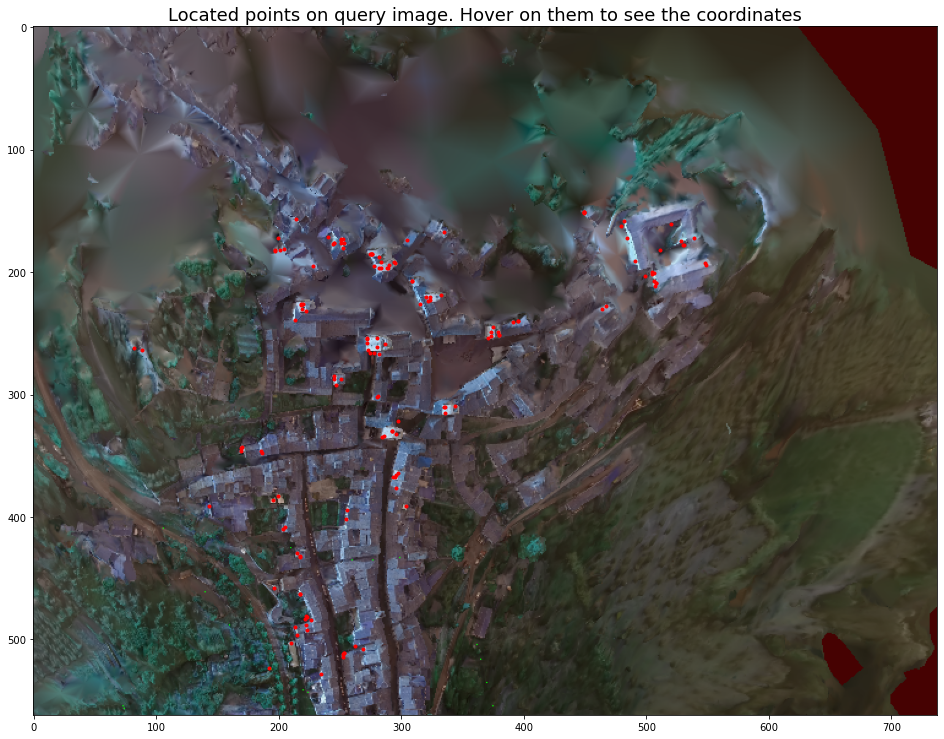

In [30]:
# Observe the recovered points over the query z0 from which we just learnt the coordinates
# Hover over the red points to see their coordinates
# The interesting coordinate matrixes are: coordis_tomap, xpoints and ypoints
# Use the crossed arrows down-left to play with the view

query = cv2.imread('./'+cap_folder+'/'+query_image+'.PNG')
fig2,ax = plt.subplots(figsize=(13,13),constrained_layout=True)

ax.imshow(query)
points = ax.scatter(xpoints,ypoints,s=9,color='r')        

labels = [str(c['long'])+' ; '+ str(c['lat']) for c in coordis_tomap]
tooltip = mpld3.plugins.PointLabelTooltip(points, labels)

mpld3.plugins.connect(fig2, tooltip)
plt.title('Located points on query image. Hover on them to see the coordinates', fontsize=18)

plt.show()

### Find the matching polylines for each output .svg

In [ ]:
# This are all the svgs

svgs_related = glob.glob("./"+cap_folder+"/0_*.svg")

In [ ]:
svgs_related

In [ ]:
# For each .SVG that relates capp.png (n0)
# Here I only use the first one

with open(svgs_related[0], 'r') as fh:
    content = fh.read()

In [ ]:
info=BeautifulSoup(content, 'html.parser').findAll("polyline")
info[0]

In [ ]:
height_out = int(BeautifulSoup(content, 'html.parser').findAll("image")[1].get('height')[0:-2])
width_out = int(BeautifulSoup(content, 'html.parser').findAll("image")[1].get('width')[0:-2])
aux = np.empty((height_out,width_out,2))
aux[:] = np.nan
coordinates_output = list(aux)
print(['Height= ',height_out,' Width= ',width_out])

In [ ]:
# Find the points of each line
# Recover the latitude and longitude pointsn using the pixels in the .svg source code and coord matrix
# Fill the new coordinates_output matrix with the recovered coordinates

coordis_tomap = []
xpoints = []
ypoints = []
for ind_line in range(len(info)):
    line = info[ind_line].get('points')
    [px1,py1,px2,py2] = [round(float(i)) for i in line.split(",")]
    print([' px1=',px1,' py1=',py1,' px2=',px2,' py2=',py2])
    long = coord[py1][px1][0]
    lat = coord[py1][px1][1]
    px2_norm = px2 - width_origin
    py2_norm = py2
    xpoints.append(px2_norm)
    ypoints.append(py2_norm)
    print([' px2_norm=',px2_norm,' py2_norm=',py2_norm,' lat=',lat,' long=',long])
    coordinates_output[py2_norm][px2_norm][0]=lat
    coordinates_output[py2_norm][px2_norm][1]=long
    coordis_tomap.append({'lat':lat,'long':long})

In [ ]:
np.array(coordinates_output).shape

In [ ]:
#Check if the matrix is correctly oriented and not empty. See whites.

plt.imshow(np.array(coordinates_output)[:,:,0])
plt.colorbar()
plt.show()

plt.imshow(np.array(coordinates_output)[:,:,1])
plt.colorbar()
plt.show()
len(coordis_tomap)

In [ ]:
# See the points that have been located
# Should zoom-in normally because it is too far away

cook = pd.DataFrame(coordis_tomap)
fig1 = px.scatter_geo(cook, lon='long', lat='lat', projection="kavrayskiy7",title='Found location of query')    
fig1.show()

In [ ]:
query_image = input('Which image is the query?')

In [ ]:
# Observe the recovered points over the query z0 from which we just learnt the coordinates
# Hover over the red points to see their coordinates
# The interesting coordinate matrixes are: coordis_tomap, xpoints and ypoints
# Use the crossed arrows down-left to play with the view

query = cv2.imread('./'+cap_folder+'/'+query_image+'.PNG')
fig2,ax = plt.subplots(figsize=(13,13),constrained_layout=True)

ax.imshow(query)


points = ax.scatter(xpoints,ypoints,s=9,color='r')        
labels = [str(c['long'])+' ; '+ str(c['lat']) for c in coordis_tomap]
tooltip = mpld3.plugins.PointLabelTooltip(points, labels)

mpld3.plugins.connect(fig2, tooltip)
plt.title('Located points on query image. Hover on them to see the coordinates', fontsize=18)
plt.show()